# Data Atelier - Prendre en main les méthodes d'explicabilités pour interpréter son modèle de machine learning !

Pour comprendre le fonctionnement des modèles de machine learning, il est proposé de comprendre un modèle appliqué au dataset en open data sur data.gouv : [Baromètre Représentations sociales du changement climatique - data.gouv.fr](https://www.data.gouv.fr/fr/datasets/barometre-representations-sociales-du-changement-climatique/)




## Import des librairies

In [1]:
import pandas as pd
import numpy as np

from category_encoders import OrdinalEncoder
from shapash.explainer.smart_explainer import SmartExplainer
from shapash.explainer.consistency import Consistency
from sklearn.model_selection import train_test_split
import catboost
import lightgbm
from category_encoders import OrdinalEncoder
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
import matplotlib.pyplot as plt
from sklearn import metrics
from eurybia import SmartDrift
import pygwalker as pyg

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', 1000)

## Import du dataset et cleaning

In [3]:
df = pd.read_csv("./data/OpinionWay pour l'ADEME - Baromètre changement climatique - Compilation 2000-2022.csv", 
                       delimiter=';',
                       encoding='Windows-1252')

/tmp/ipykernel_136435/1010999897.py:1: DtypeWarning:

Columns (6,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,41,42,43,44,45,46,47,48,49,50,51,53,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,166,169,170,171,172,173,174,176,177,180,182) have mixed types. Specify dtype option on import or set low_memory=False.



In [4]:
df.head()

,Vague,S1. genre,S2. âge,S3. Zone géo,Région,Département,S7. Taille commune,S7b. Taille commune,S7c. Taille commune,S6. Situation professionnelle,S5. CSP,q1_1. Enjeu important 1,q1_2. Enjeu important 2,q1_3. Enjeu important 3,q1total. Enjeu Emploi,q1total. Enjeu Sécurité,q1total. Enjeu Education et recherche,q1total. Enjeu Inégalités,q1total. Enjeu Logement,q1total. Enjeu Impôts et taxes,q1total. Enjeu Hausse des prix,q1total. Enjeu Immigration,q1total. Enjeu Environnement/Transition écologique,q1total. Enjeu Déficits publics,q1total. Enjeu Banlieues,q1total. Enjeu Transports,q1total. Enjeu Santé publique,q1total. Enjeu No rep.,q2_1. Problème environnemental 1,q2_2. Problème environnemental 2,q2total. Problème pollution de l'air,q2total. Problème pollution de l'eau,q2total. Problème bruit,q2total. Problème risques nucléaire,q2total. Problème déchets,q2total. Problème dégradation biodiversité,q2total. Problème Effet de serre/ réchauffement climatique,q2total. Problème dégradation des paysages,q2total. Problème aucun,q2total. Problème No rep.,q5. Certitude/hypothèse impact effet de serre,q8. Conséquences changement climatique,q8bis_1. Inquiétude conséquence 1,q8bis_2. Inquiétude conséquence 2,q8bis_total. Inquiétude catastrophe naturelle,q8bis_total. Inquiétude conflits entre Etats,q8bis_total. Inquiétude migrations population,q8bis_total. Inquiétude conflits politiques et sociaux,q8bis_total. Inquiétude développement maladies,q8bis_total. Inquiétude réchauffement températures,q8bis_total. aucun,q8bis_total. No rep.,q9. Causes désordres du climat,q10. Causes anthropiques/naturelles du changement climatique,q11. Solutions changement climatique,q12. Opportunité/ contrainte changement,q13_1. Conditions acceptation changement 1,q13_2. Conditions acceptation changement 2,q13total. Condition changements modérés,q13total. Condition compensation,q13total. Condition équité,q13total. Condition participation,q13total. Condition acceptation dans tous les cas,q13total. Condition No rep.,q14. Médiatisation changement climatique,q14b. Pourquoi souhaitez-vous qu'on en parle plus ?,q15_1. Acteur efficace 1,q15_2. Acteur efficace 2,q15total. instances internationales,q15total. Etats,q15total. collectivités locales,q15total. entreprises,q15total. associations,q15total. Chacun d'entre nous,q15total. Personne,q15total. No rep.,q15b_1. Acteur actif 1,q15b_2. Acteur actif 2,q15btotal. instances internationales,q15btotal. Etats,q15btotal. collectivités locales,q15btotal. entreprises,q15btotal. associations,q15btotal. Chacun d'entre nous,q15btotal. Personne,q15btotal. No rep.,q16. Optimisme limitation changement climatique,q18_i1. Causes GES activités industrielles,q18_i2. Causes GES transports,q18_i3. Causes GES bâtiments,q18_i4. Causes GES agriculture,"q18_i5. Causes GES centrales de production d'électricité au gaz, charbon ou fuel",q18_i6. Causes GES traitement des déchets,q18_i7. Causes GES destruction des forêts,q18_i8. Causes GES centrales nucléaires,q18_i9. Causes GES activité volcanique,q18_i10. Causes GES bombes aérosols,q18_i11. Causes GES numérique,q19_1. Action efficace réduction GES 1,q19_2. Action efficace réduction GES 2,q19total. Action efficace Achat voiture consommant moins,"q19total. Action efficace covoiturage, autopartage",q19total. Action efficace modes alternatifs voiture,q19total. Action efficace isolation logement,"q19total. Action efficace chauffage, chauffe-eau performant",q19total. Action efficace Appareils ménagers consommant moins,q19total. Action efficace EnR pour son logement,q19total. Action efficace consommer moins ou produits ayant moins d’impact,q19total. Action efficace réduire trier ses déchets,q19total. Action efficace télétravail,q19total. Action efficace No rep.,splitq20,q20_i1. Action individuelle Tri déchets,q20_i2. Actin individuelle Eteindre appareils en veille,q20_i3. Actin individuelle Transports en commun,q20_i4. Actin individuelle Baisse température logement,q20_i5. Actin individuelle Acheter légumes de s

In [6]:
# création d'une variable sur une note moyenne des actions individuelles que le sondé est prêt à faire
notes_mapping = {
    '...vous le faites déjà': 4,
    '...vous pourriez le faire assez facilement': 3,
    '...vous pourriez le faire mais difficilement': 2,
    '...vous ne pouvez pas le faire': 1
}

def calculer_moyenne(row):
    notes = [notes_mapping[val] for val in row if val != 'No rep.']
    return sum(notes) / len(notes) if notes else 0

df_q20 = df.filter(like='q20', axis=1).replace({'nan': 'No rep.', np.nan: 'No rep.'})

colonnes_action_individuelle = df_q20.filter(like='q20').drop(columns=['splitq20'])

df_q20['moyenne_action_individuelle'] = colonnes_action_individuelle.apply(calculer_moyenne, axis=1)

df_q20['moyenne_action_individuelle'].round().value_counts()

3.0    13819
0.0     7407
4.0     4949
2.0     1589
1.0      104
Name: moyenne_action_individuelle, dtype: int64

In [7]:
df = pd.concat([df, df_q20[['moyenne_action_individuelle']]], axis=1)

In [8]:
# Dictionnaire de renommage des colonnes pour avoir un nom plus simple et court
columns_to_rename = {'S1. genre' : 'genre',
                      'S2. âge' : 'tranche_age',
                      'S3. Zone géo' : 'zone_geo',
                      'Région' : 'region',
                      'Département' : 'departement',
                      'S7b. Taille commune' : 'taille_commune',
                      'S6. Situation professionnelle' : 'situation_pro',
                      'S5. CSP' : 'csp',
                      'q5. Certitude/hypothèse impact effet de serre' : 'impact_effet_de_serre',
                      'q9. Causes désordres du climat' : 'cause_desordre',
                      's11. Désordre climatique subi' : "changement_subi",
                      'q10. Causes anthropiques/naturelles du changement climatique' : 'cause_changement_climatique',
                      'q11. Solutions changement climatique' : 'solutions',
                      'q18_i1. Causes GES activités industrielles' : 'causes_ges_industries', 
                      'q18_i2. Causes GES transports' : 'causes_ges_transports',
                      'q18_i3. Causes GES bâtiments' : 'causes_ges_batiments',
                      'q18_i4. Causes GES agriculture' : 'causes_ges_agriculture',
                      "q18_i5. Causes GES centrales de production d'électricité au gaz, charbon ou fuel"  : 'causes_ges_energie',
                      'q18_i6. Causes GES traitement des déchets' : 'causes_ges_dechets',
                      'q18_i7. Causes GES destruction des forêts' : 'causes_ges_forets',
                      'q18_i8. Causes GES centrales nucléaires': 'causes_ges_nucleaires',
                      'q18_i9. Causes GES activité volcanique' : 'causes_ges_volcans',
                      'q18_i10. Causes GES bombes aérosols' : 'causes_ges_aerosols',
                      'q18_i11. Causes GES numérique' : 'causes_ges_numeriques',
                      's13. Nb membres foyer' :'nb_membres_foyer',
                      's15. Diplôme' :'diplome', 
                      's17. Type habitat' : 'type_habitat',
                      's18. Statut locataire/propriétaire' : 'locataire_proprietaire',
                      's22. Mode de transport' : 'mode_transport',
                      's23. Partis politiques' : 'partis_politiques', 
                      's24. Echiquier politique' : 'echiquier_politiques',
                      's25. Sympathie mouvements écologistes' : 'sympathie_ecologie',
                      'q23. Véracité scientifique' : 'veracite_scientifique',
                      'q14. Médiatisation changement climatique' : 'mediatisation',
                      'q8. Conséquences changement climatique' : 'futures_consequences',
                      'q16. Optimisme limitation changement climatique' : 'limitation_changement',
                      'q13total. Condition changements modérés' : 'changements_moderes',
                      "q15btotal. associations" : "associations_acteurs",
                      "q15total. collectivités locales" : "collectivites_acteurs",
                      'q21_i1. Mesures Baisse vitesse autoroute' : 'baisse_vitesse_autoroute',
                      'q21_i10. Mesures Favoriser véhicules peu polluants' : 'favoriser_mobilite_douce',
                      'q21_i11. Mesures Menu restauration collective' : 'mesure_restauration'
                      }

In [9]:
df.rename(columns=columns_to_rename, inplace=True)

In [10]:
# Sélection de features à conserver pour le modèle
features = ['Vague',
            'genre',
            'tranche_age',
            'zone_geo',
            'region',
            'departement',
            'taille_commune',
            'situation_pro',
            'csp',
            'impact_effet_de_serre',
            'cause_desordre',
            'cause_changement_climatique',
            'solutions',
            'causes_ges_industries', 
            'causes_ges_transports',
            'causes_ges_batiments',
            'causes_ges_agriculture',
            'causes_ges_energie',            
            'causes_ges_forets',
            'causes_ges_nucleaires',
            'causes_ges_volcans',
            'causes_ges_aerosols',
            #'causes_ges_numeriques',
            'nb_membres_foyer',
            'diplome', 
            'type_habitat',
            'locataire_proprietaire',
            'mode_transport',
            'echiquier_politiques', 
            'sympathie_ecologie',
            'changement_subi',
            'veracite_scientifique',
            'mediatisation',
            'futures_consequences',
            'limitation_changement',
            'changements_moderes',
            #'associations_acteurs',
            #'collectivites_acteurs',
            'moyenne_action_individuelle'
                      ]

In [11]:
#suppressions des lignes avec trop de valeurs vides et la cible "solutions" non répondu
print(df.shape)
df_reduit = df[features].copy()
df_reduit['number_of_NaNs'] = df_reduit.isnull().sum(axis=1)
df_reduit = df_reduit[df_reduit["number_of_NaNs"]<10]                      
df_reduit = df_reduit[df_reduit["solutions"] !="No rep."]
print(df_reduit.shape)

(27868, 184)
(17642, 37)


In [12]:
df_reduit.isna().sum()

Vague                             0
genre                             0
tranche_age                       0
zone_geo                          0
region                            0
departement                       0
taille_commune                    0
situation_pro                     0
csp                            3967
impact_effet_de_serre             0
cause_desordre                    0
cause_changement_climatique       0
solutions                         0
causes_ges_industries             0
causes_ges_transports             0
causes_ges_batiments              0
causes_ges_agriculture            0
causes_ges_energie                0
causes_ges_forets                 0
causes_ges_nucleaires             0
causes_ges_volcans                0
causes_ges_aerosols               0
nb_membres_foyer                  0
diplome                           0
type_habitat                      0
locataire_proprietaire            0
mode_transport                    0
echiquier_politiques        

### Renommage des modalités 
Nous renommons les modalités de certaines colonnes pour un meilleur affichage

In [13]:
df_reduit.loc[df_reduit['cause_changement_climatique'] == 'Le réchauffement de la planète est causé par les activités humaines', 'cause_changement_climatique'] = 'activites_humaines'
df_reduit.loc[df_reduit['cause_changement_climatique'] == "Il s'agit uniquement d'un phénomène naturel qui a toujours existé", 'cause_changement_climatique'] = 'phenomene_naturel'

In [14]:
df_reduit.loc[df_reduit['impact_effet_de_serre'] == '...ou bien une certitude pour la plupart des scientifiques ?', 'impact_effet_de_serre'] = 'certitude_scientifique'
df_reduit.loc[df_reduit['impact_effet_de_serre'] == "...une hypothèse sur laquelle les scientifiques ne sont pas tous d'accord ?", 'impact_effet_de_serre'] = 'hypothese_non_certaine'

In [15]:
df_reduit.loc[df_reduit['sympathie_ecologie'] == '...assez de sympathie ?', 'sympathie_ecologie'] = 'assez'
df_reduit.loc[df_reduit['sympathie_ecologie'] == "...peu de sympathie ?", 'sympathie_ecologie'] = 'peu'
df_reduit.loc[df_reduit['sympathie_ecologie'] == "...beaucoup de sympathie ?", 'sympathie_ecologie'] = 'beaucoup'
df_reduit.loc[df_reduit['sympathie_ecologie'] == "...pas de sympathie ?", 'sympathie_ecologie'] = 'pas'

In [16]:
df_reduit.loc[df_reduit['cause_desordre'] == 'Les désordres du climat et leurs conséquences (tels que les canicules, les tempêtes, les sécheresses et les inondati', 'cause_desordre'] = 'certitudes_causes'
df_reduit.loc[df_reduit['cause_desordre'] == "Aujourd'hui, personne ne peut dire avec certitude les vraies raisons des désordres du climat", 'cause_desordre'] = 'pas_certitude'

In [17]:
# Cette variable est la cible du modèle
df_reduit.loc[df_reduit['solutions'] == 'Il faudra modifier de façon importante nos modes de vie pour limiter le changement climatique', 'solutions'] = 'changer'
df_reduit.loc[df_reduit['solutions'].str.contains("le changement climatique est inévitable") , 'solutions'] = 'inevitable'
df_reduit.loc[df_reduit['solutions'] == "C'est aux Etats de rechercher un accord au niveau mondial pour limiter le changement climatique", 'solutions'] = 'entre_etats'
df_reduit.loc[df_reduit['solutions'] == "Le progrès technique permettra de trouver des solutions pour limiter le changement climatique", 'solutions'] = 'progres'

In [18]:
# pour faire un modèle de classification binaire simplifié
df_reduit.loc[df_reduit['solutions'] == 'entre_etats', 'solutions'] = 'ne_pas_changer'
df_reduit.loc[df_reduit['solutions'] == 'inevitable', 'solutions'] = 'ne_pas_changer'
df_reduit.loc[df_reduit['solutions'] == 'progres', 'solutions'] = 'ne_pas_changer'


In [19]:
df_reduit = df_reduit[df_reduit['solutions'].isin(["changer","ne_pas_changer"])]


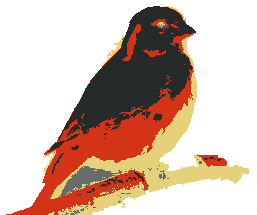

INFO:backoff:Backing off send_request(...) for 38.4s (requests.exceptions.ConnectTimeout: HTTPSConnectionPool(host='api.segment.io', port=443): Max retries exceeded with url: /v1/batch (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x7f552c6226b0>, 'Connection to api.segment.io timed out. (connect timeout=15)')))
INFO:backoff:Backing off send_request(...) for 184.3s (requests.exceptions.ConnectTimeout: HTTPSConnectionPool(host='api.segment.io', port=443): Max retries exceeded with url: /v1/batch (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x7f552c622110>, 'Connection to api.segment.io timed out. (connect timeout=15)')))
INFO:backoff:Backing off send_request(...) for 165.8s (requests.exceptions.ConnectTimeout: HTTPSConnectionPool(host='api.segment.io', port=443): Max retries exceeded with url: /v1/batch (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x7f552c6cfe20>, 'Connection to api.segment.io

In [22]:
walker = pyg.walk(df_reduit, env="Jupyter")

## Modélisation

In [23]:
y = df_reduit["solutions"]
X = df_reduit.drop(["solutions","number_of_NaNs"], axis=1)

In [24]:
#Conversion des variables catégorielles en numérique
features_cat = [e for e in features if e not in ("solutions", "moyenne_action_individuelle")]

encoder = OrdinalEncoder(
    cols=features_cat,
    handle_unknown='ignore',
    return_df=True).fit(X)

X=encoder.transform(X)

In [25]:
encoder_target = OrdinalEncoder(
    cols=["solutions"],
    handle_unknown='ignore',
    return_df=True).fit(y)

y=encoder_target.transform(y)

In [26]:
Xtrain, Xtest, ytrain, ytest = train_test_split(
    X, y, train_size=0.75, random_state=1
)

model = catboost.CatBoostClassifier()
model.fit(Xtrain, ytrain, verbose=False)

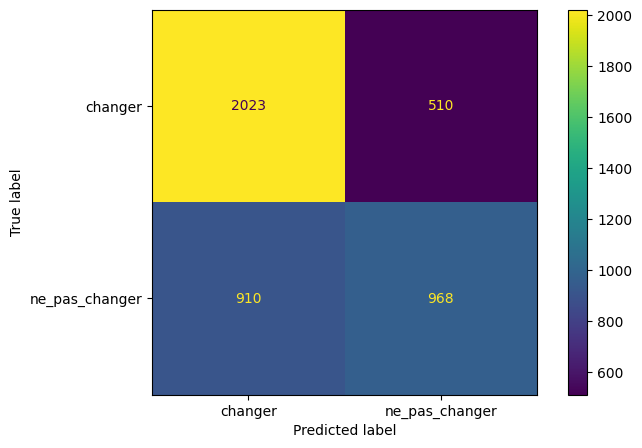

0.6570498388261109

In [27]:
prediction = model.predict(Xtest)

fig, ax = plt.subplots(figsize=(8, 5))
cmp = ConfusionMatrixDisplay(
    confusion_matrix(ytest, prediction), display_labels=["changer","ne_pas_changer"])


cmp.plot(ax=ax)
plt.show()

fpr, tpr, thresholds = metrics.roc_curve(ytest, prediction, pos_label=2)
metrics.auc(fpr, tpr)

In [28]:
encoder_target

OrdinalEncoder(cols=['solutions'], handle_unknown='ignore',
               mapping=[{'col': 'solutions', 'data_type': dtype('O'),
                         'mapping': changer           1
ne_pas_changer    2
NaN              -2
dtype: int64}])

<hr>
<h1>Interprétabilité avec Shapash</h1>
<hr>

In [29]:
response_dict = {1: 'changer', 2:'ne_pas_changer'}

In [30]:
#Init Shapash
xpl = SmartExplainer(model=model,preprocessing=encoder, label_dict=response_dict) 

In [31]:
# Compilation de Shapash
xpl.compile(
    x=Xtest,    
    y_target = ytest
)

In [32]:
#Lancement de la webapp
app=xpl.run_app(port=8080)

INFO:root:Your Shapash application run on http://slhdg003:8080/
INFO:root:Use the method .kill() to down your app.


In [169]:
app.kill()

Questions ?


les principaux éléments qui expliquent la classification en "changer" et "ne_pas_changer" 

les principaux éléments qui expliquent les erreurs de prédictions

les profils où la prédiction est à la limite

des anomalies 

des analyses par sous population


<hr>
<h1>Indicateurs de confiance dans les explicabilités</h1>
<hr>

3 indicateurs sont proposés dans Shapash pour mesurer la confiance que l'on peut en avoir dans son explicabilité

## Consistency

Cette métrique permet de mesurer la distance moyenne entre 2 explicabilités

### Comparaison pour 2 modèles différents
Nous pouvons mesurer la consistance entre 2 explicabilités qui proviennent de 2 modèles différents (exemples : xgboost, lightgbm)

A noter qu'il est possible également de mesurer la consistance entre 2 explicabilités compilés avec 2 méthodes différentes (exemple : shap & lime)

### Modèle lightgbm pour comparaison avec catboost

In [34]:
model_lgb = lightgbm.LGBMClassifier()
model_lgb.fit(Xtrain, ytrain)

/data_tech/users/users_envs/78257d/shapash237/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:97: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/data_tech/users/users_envs/78257d/shapash237/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:132: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



[LightGBM] [Info] Number of positive: 5752, number of negative: 7479
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 13231, number of used features: 35
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.434737 -> initscore=-0.262551
[LightGBM] [Info] Start training from score -0.262551


LGBMClassifier()

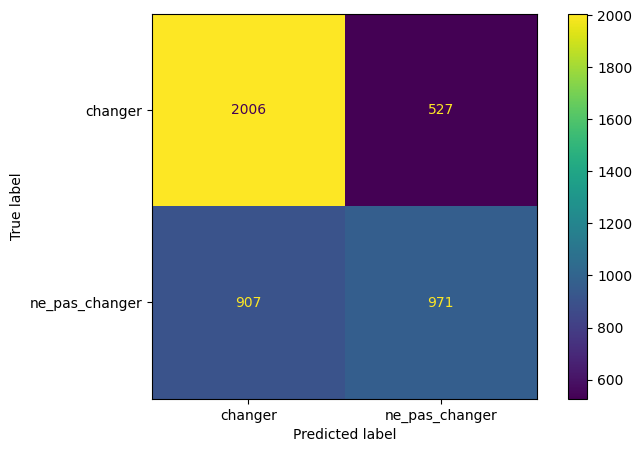

0.6544928561728527

In [35]:
prediction_lgb = model_lgb.predict(Xtest)

fig, ax = plt.subplots(figsize=(8, 5))
cmp = ConfusionMatrixDisplay(
    confusion_matrix(ytest, prediction_lgb), display_labels=["changer","ne_pas_changer"])


cmp.plot(ax=ax)
plt.show()

fpr, tpr, thresholds = metrics.roc_curve(ytest, prediction_lgb, pos_label=2)
metrics.auc(fpr, tpr)

In [36]:
xpl_lgb = SmartExplainer(model=model_lgb,preprocessing=encoder, label_dict=response_dict)
xpl_lgb.compile(
    x=Xtest,    
    y_target = ytest
)

### Compilation de la méthode Consistency

In [37]:
contributions = {"catboost_shap": xpl.contributions[0], "lightgbm_shap": xpl_lgb.contributions[0]}

In [48]:
cns = Consistency()
cns.compile(x=Xtest.reset_index(drop=True), # Dataset for which we need explanations
            contributions=contributions
            )

/data_tech/users/users_envs/78257d/shapash237/lib/python3.10/site-packages/sklearn/manifold/_mds.py:298: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



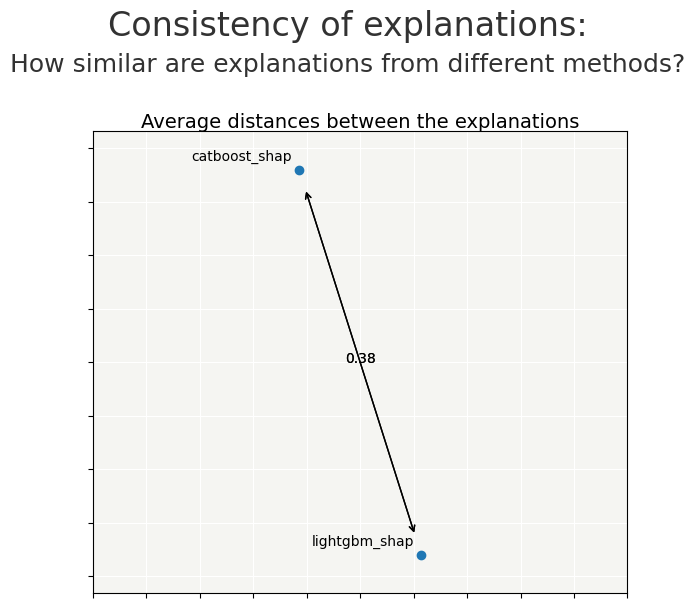

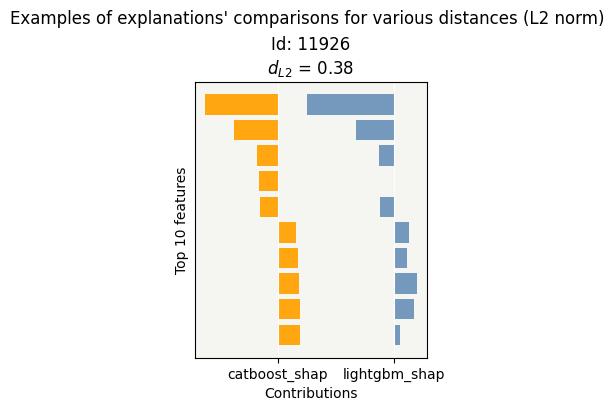

In [49]:
cns.consistency_plot(max_features=10)


In [50]:
#Cette figure représente l'écart de distributions entre les explicabilités par feature
cns.pairwise_consistency_plot(methods=["catboost_shap", "lightgbm_shap"], max_features=5)

In [55]:
#Cette figure permet de voir les interactions des contributions entre 2 features
#xpl.plot.top_interactions_plot(nb_top_interactions=5)

## Compacity

Cette métrique permet de visualiser le nombre de features nécessaires pour expliquer un % de la prédiction. 

In [56]:
xpl.plot.compacity_plot()

## Stability

Cette métrique permet de visualiser la stabilité de l'explicabilité en comparant les explicabilités entre proches voisins

In [57]:
#Pour un individu
xpl.plot.local_neighbors_plot(index=19360)

In [58]:
#Au global
xpl.plot.stability_plot()

In [59]:
#Au global
xpl.plot.stability_plot(max_features=5, distribution="boxplot")

Computed values from previous call are used


# Stabilité des données

L'idée est de voir si les données sont similaires entre les périodes de sondages et si la période d'apprentissage est adaptée et que les données sont similaires

In [60]:
xpl.x_init.Vague.value_counts()

Vague 15    402
Vague 22    399
Vague 23    395
Vague 21    394
Vague 20    389
Vague 18    382
Vague 17    361
Vague 16    355
Vague 19    351
Vague 14    259
Vague 11    253
Vague 13    239
Vague 12    232
Name: Vague, dtype: int64

In [61]:
df_periode1 = df_reduit[df_reduit['Vague'].isin(['Vague 11','Vague 12','Vague 13','Vague 14','Vague 15','Vague 16','Vague 17'])].drop(["Vague","solutions","number_of_NaNs"], axis=1)
df_periode2 = df_reduit[~df_reduit['Vague'].isin(['Vague 11','Vague 12','Vague 13','Vague 14','Vague 15','Vague 16','Vague 17'])].drop(["Vague","solutions","number_of_NaNs"], axis=1)

In [62]:
sd = SmartDrift(
    df_current=df_periode1,
    df_baseline=df_periode2,
    #deployed_model=model,  # Optional: put in perspective result with importance on deployed model
    #encoding=encoder,  # Optional: if deployed_model and encoder to use this model
    dataset_names={
        "df_current": "Vague 18 - 23",
        "df_baseline": "Vague 11 - 17",
    },  # Optional: Names for outputs
)

In [63]:
sd.compile()

ERROR:backoff:Giving up send_request(...) after 11 tries (requests.exceptions.ConnectTimeout: HTTPSConnectionPool(host='api.segment.io', port=443): Max retries exceeded with url: /v1/batch (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x7f53a8536170>, 'Connection to api.segment.io timed out. (connect timeout=15)')))
ERROR:segment:error uploading: HTTPSConnectionPool(host='api.segment.io', port=443): Max retries exceeded with url: /v1/batch (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x7f53a8536170>, 'Connection to api.segment.io timed out. (connect timeout=15)'))


In [64]:
sd.generate_report(
    output_file="stabilite_vague.html",
    title_story="Stabilité Vague"
)

App saved to ./stabilite_vague.html

In [65]:
df_reduit.drop('Vague', 1).isna().groupby(df.Vague, sort=False).sum().reset_index()

/tmp/ipykernel_136435/1263096022.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.



,Vague,genre,tranche_age,zone_geo,region,departement,taille_commune,situation_pro,csp,impact_effet_de_serre,cause_desordre,cause_changement_climatique,solutions,causes_ges_industries,causes_ges_transports,causes_ges_batiments,causes_ges_agriculture,causes_ges_energie,causes_ges_forets,causes_ges_nucleaires,causes_ges_volcans,causes_ges_aerosols,nb_membres_foyer,diplome,type_habitat,locataire_proprietaire,mode_transport,echiquier_politiques,sympathie_ecologie,changement_subi,veracite_scientifique,mediatisation,futures_consequences,limitation_changement,changements_moderes,moyenne_action_individuelle,number_of_NaNs
0,Vague 11,0,0,0,0,0,0,0,988,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,988,0,988,0,0,0,988,988,0,0
1,Vague 12,0,0,0,0,0,0,0,996,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,996,0,996,0,0,0,996,996,0,0
2,Vague 13,0,0,0,0,0,0,0,990,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,990,0,990,0,0,0,990,990,0,0
3,Vague 14,0,0,0,0,0,0,0,993,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,993,0,993,0,0,0,993,993,0,0
4,Vague 15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1542,0,0
5,Vague 16,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,Vague 17,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,Vague 18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,Vague 19,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,Vague 20,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<hr>
<h1>Génération du rapport Shapash</h1>
<hr>

Le rapport permet d'avoir une version figée de l'explicabilité. Il peut avoir plusieurs objectifs : à des fins de traçabilité, d'archivage, d'audit,....



In [ ]:
xpl.generate_report(
    output_file='report_barometre_changement_climatique.html',
    project_info_file='./project_info_barometre.yml',
    x_train=Xtrain,
    y_train=ytrain,
    y_test=ytest,
    title_story="Barometre Changement Climatique",
    title_description="""Ce rapport contient la description et l'explicabilité d'un modèle de prédiction
    de la solution envisagée par des sondés face aux problématique du changement climatique""",
    metrics=[{'name': 'AUC', 'path': 'sklearn.metrics.roc_auc_score'}]
)

Executing:   0%|          | 0/15 [00:00<?, ?cell/s]